##**FOREWORD**

Please note that this project was completed and compiled within this final notebook using a **Google Collab Pro+ High Resource Run-Time**. If you choose to re-run this notebook, **please ensure you have the necessary GPU and RAM resources available**. 

Please also note that accuracy metrics and run time values quoted within the cells are subject to the output of the code; if you re-run the code, you'll see values that are **very similar** to quoted values but they may not exactly match. 

#Environment Setup

##**Confirming High Resource Run Time**

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Sun May  1 18:01:21 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    25W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 27.3 gigabytes of available RAM

You are using a high-RAM runtime!


##**Including Facenet and MTCNN**

In [ ]:
!pip install facenet-pytorch

In [ ]:
!pip install mtcnn

##**Including All Dependencies for Notebook**

In [ ]:
import numpy as np
from numpy.linalg import norm
import pickle
from tqdm import tqdm, tqdm_notebook
import os
import random
import time
import math
from facenet_pytorch import MTCNN, InceptionResnetV1
import numpy as np
import tensorflow_datasets as tfds
import tensorflow
from sklearn.neighbors import NearestNeighbors
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import PIL
from PIL import Image
import glob
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.model_selection import train_test_split
import torch
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.applications.inception_resnet_v2 import InceptionResNetV2

%matplotlib inline


##**Using gdown to retrieve images**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
! gdown http://vis-www.cs.umass.edu/lfw/lfw.tgz --output lfw.tar.gz
! tar -xvf lfw.tar.gz

Streaming output truncated to the last 5000 lines.
lfw/Luis_Sanchez/
lfw/Luis_Sanchez/Luis_Sanchez_0001.jpg
lfw/Juliette_Binoche/
lfw/Juliette_Binoche/Juliette_Binoche_0001.jpg
lfw/Joel_Todd/
lfw/Joel_Todd/Joel_Todd_0001.jpg
lfw/Allan_Wagner/
lfw/Allan_Wagner/Allan_Wagner_0001.jpg
lfw/Alejandro_Fernandez/
lfw/Alejandro_Fernandez/Alejandro_Fernandez_0001.jpg
lfw/Guillaume_Depardieu/
lfw/Guillaume_Depardieu/Guillaume_Depardieu_0001.jpg
lfw/Delphine_Chuillot/
lfw/Delphine_Chuillot/Delphine_Chuillot_0001.jpg
lfw/Paul_LeClerc/
lfw/Paul_LeClerc/Paul_LeClerc_0001.jpg
lfw/Eddie_Jordan/
lfw/Eddie_Jordan/Eddie_Jordan_0001.jpg
lfw/Lionel_Richie/
lfw/Lionel_Richie/Lionel_Richie_0001.jpg
lfw/Lionel_Richie/Lionel_Richie_0002.jpg
lfw/Jose_Viegas_Filho/
lfw/Jose_Viegas_Filho/Jose_Viegas_Filho_0001.jpg
lfw/Jose_Viegas_Filho/Jose_Viegas_Filho_0002.jpg
lfw/Roger_Mahony/
lfw/Roger_Mahony/Roger_Mahony_0001.jpg
lfw/Clay_Aiken/
lfw/Clay_Aiken/Clay_Aiken_0001.jpg
lfw/Clay_Aiken/Clay_Aiken_0002.jpg
lfw/Clay_Ai

##**Retrieve File Paths**

Helper function to retrieve LFW images from root directory once gdown is complete with image retrieval and the drive has been mounted.

In [ ]:
extensions = ['.jpg', '.JPG', '.jpeg', '.JPEG', '.png', '.PNG']

def get_file_list(root_dir):
    file_list = []
    for root, directories, filenames in os.walk(root_dir):
        for filename in filenames:
            if any(ext in filename for ext in extensions):
                filepath = os.path.join(root, filename)
                if os.path.exists(filepath):
                  file_list.append(filepath)
                else:
                  print(filepath)
    return file_list

Confirm that all 13233 images in the dataset have been downloaded successfully. 

In [ ]:
from sklearn.model_selection import train_test_split

# path to the datasets
root_dir = '/content/lfw'
filenames = sorted(get_file_list(root_dir))
print(len(filenames))

13233


Identify and group together the images basd on the names of the people represented. Generate counts of images per class (person) and retrieve index positions for images belonging to classes with atleast 5 representative images for later evaluation. 

In [ ]:
# Helper function to get the classname (or the person the image belongs to) for the image
def classname(str):
    return str.split('/')[-2]

#Collect all classes
classes = []

for i in tqdm_notebook(range(len(filenames))):
    classes.append(classname(filenames[i]))

#Collect the number of images per class and collect into a dictionary
freq = {} 
for item in classes: 
  if (item in freq): 
    freq[item] += 1
  else: 
    freq[item] = 1

#Collect the counts and the frequencies for the images in multi-cardinality classes where cardinality > 4. 
count = 0
multi = {}
for key in freq:
  if freq[key] > 4:
    count+=1
    multi[key] = freq[key]

#Retrieve index locations in database of images for these images.
repeated_images = 0
for key in multi:
  repeated_images += multi[key]

filenames_multi = []
indexes_multi = []

for i in tqdm_notebook(range(len(filenames))):
    if classname(filenames[i]) in multi:
      filenames_multi.append(filenames[i])
      indexes_multi.append(i)

print()
print()
print("The number of people with atleast 5 images in the data set are: ", count)
print("The number of images in the data set belonging to a class with atleast 5 images in it are: ", repeated_images)


names = ["Albert_Costa", "Angela_Bassett", "Arminio_Fraga", "Billy_Crystal", "Bob_Graham",
         "Boris_Becker", "Bulent_Ecevit", "Calista_Flockhart", "Cameron_Diaz", "Carmen_Electra"]

test_images_group = []

for i in range(len(filenames)):
  if classname(filenames[i]) in names:
    test_images_group.append(filenames[i])

test_images = []

for i in range(len(test_images_group)):
  if i%6==0:
    test_images.append(test_images_group[i])

test_image_indices = []

for i in tqdm_notebook(range(len(filenames))):
    if filenames[i] in test_images:
      test_image_indices.append(i)



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


  0%|          | 0/13233 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:35: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


  0%|          | 0/13233 [00:00<?, ?it/s]



The number of people with atleast 5 images in the data set are:  423
The number of images in the data set belonging to a class with atleast 5 images in it are:  5985


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:63: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


  0%|          | 0/13233 [00:00<?, ?it/s]

In [ ]:
#Index Positions of images belonging to classes with multiple images ( > 4)
print(indexes_multi)

[31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 120, 121, 122, 123, 124, 132, 133, 134, 135, 136, 161, 162, 163, 164, 165, 166, 167, 168, 173, 174, 175, 176, 177, 178, 179, 186, 187, 188, 189, 190, 201, 202, 203, 204, 205, 209, 210, 211, 212, 213, 214, 244, 245, 246, 247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 357, 358, 359, 360, 361, 362, 363, 364, 392, 393, 394, 395, 396, 407, 408, 409, 410, 411, 412, 413, 414, 415, 416, 417, 418, 419, 420, 421, 422, 423, 424, 425, 426, 427, 428, 429, 430, 431, 432, 433, 434, 435, 436, 437, 438, 439, 440, 441, 459, 460, 461, 462, 463, 464, 465, 466, 467, 468, 469, 470, 471, 472, 473, 474, 475, 476, 477, 478, 479, 480, 481, 482, 483, 484, 485, 486, 504, 505, 506, 507, 508, 509, 510, 512, 513, 514, 515, 516, 517, 518, 519, 535, 536

In [ ]:
#Classes with multiple images ( > 4 ) and the class counts
print(len(multi))

423


In [ ]:
print(len(indexes_multi))

5985


In [ ]:
test_images

['/content/lfw/Albert_Costa/Albert_Costa_0001.jpg',
 '/content/lfw/Angela_Bassett/Angela_Bassett_0001.jpg',
 '/content/lfw/Arminio_Fraga/Arminio_Fraga_0001.jpg',
 '/content/lfw/Billy_Crystal/Billy_Crystal_0001.jpg',
 '/content/lfw/Bob_Graham/Bob_Graham_0001.jpg',
 '/content/lfw/Boris_Becker/Boris_Becker_0001.jpg',
 '/content/lfw/Bulent_Ecevit/Bulent_Ecevit_0001.jpg',
 '/content/lfw/Calista_Flockhart/Calista_Flockhart_0001.jpg',
 '/content/lfw/Cameron_Diaz/Cameron_Diaz_0001.jpg',
 '/content/lfw/Carmen_Electra/Carmen_Electra_0001.jpg']

In [ ]:
test_image_indices

[209, 642, 901, 1338, 1390, 1445, 1601, 1616, 1624, 1751]

#**Baseline**

##**Overview**

In this section, an initial baseline reverse visual search engine is constructed by using a combination of a pre-trained model and a K-NearestNeighbor classifier. The pipeline for the baseline search engine is relatively straightforward:

1. Initially, a ResNet50 model and an InceptionResNet model were generated with imagenet weights.

2. These models were then used to extract the features across all of the images in the LFW dataset.

3. Two KNN classifiers were then fit across the embeddings generated in the previous step.

The combination of `{model: ResNet50, embeddings:feature_list1, neighbors1}` and
`{model: InceptionResNet, embeddings:feature_list2, neighbors2} ` are presented below as the baseline reverse visual search engines our team hoped to improve upon. 

##Generate Baseline Models and Embeddings

ResNet50 and InceptionResNetV2 models generated with pretrained weights based on imagenet. ResNet50 was chosen as one of the baseline models based on the provided AWS guide and overview. InceptionResNet was chosen as the other baseline model in order to highlight how the VGGFace weights and MTCNN training pipeline results in improved face recognition and capture on the improvements section. 

In [ ]:
model1 = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3), pooling='max')
model2 = InceptionResNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3), pooling='max')

219070464/219055592 [==============================] - 1s 0us/step


Helper function defined to use models to generate embeddings from the images in the LFW dataset. For the function below, when given an image path, the function will load the appropriate image and then convert it into an array for the models to generate embeddings on after passing through preprocessing. The generated embeddings are then flattened and normalized before being output. 

In [ ]:
def extract_features(img_path, model):
    input_shape = (224, 224, 3) #Input Shape for the baseline models selected
    img = image.load_img(img_path, target_size=(input_shape[0], input_shape[1])) #Load images from the image data set directory
    img_array = image.img_to_array(img) #Convert image to array
    expanded_img_array = np.expand_dims(img_array, axis=0)
    preprocessed_img = preprocess_input(expanded_img_array) #Preprocess array
    features = model.predict(preprocessed_img) #Extract embeddings
    flattened_features = features.flatten() #Flatten and normalize
    normalized_features = flattened_features / norm(flattened_features) #Flatten and normalize
    return normalized_features

Function tested on first test image in the dataset; the ResNet50 model generated 2048 embeddings per image while InceptionResnetV2 generated 1536 embeddings per image. 

In [ ]:
features = extract_features('/content/lfw/AJ_Cook/AJ_Cook_0001.jpg', model1)
print("Total length of features for one image using resnet: ", len(features))

features = extract_features('/content/lfw/AJ_Cook/AJ_Cook_0001.jpg', model2)
print("Total length of features for one image using inception: ", len(features))

Total length of features for one image using resnet:  2048
Total length of features for one image using inception:  1536


Embeddings extracted from all images in the dataset to construct a database of embeddings for the classifier. 

In [ ]:
resnet__feature_list = []
for i in tqdm_notebook(range(len(filenames))):
    resnet__feature_list.append(extract_features(filenames[i], model1))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


  0%|          | 0/13233 [00:00<?, ?it/s]

In [ ]:
inception_feature_list = []
for i in tqdm_notebook(range(len(filenames))):
    inception_feature_list.append(extract_features(filenames[i], model2))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


  0%|          | 0/13233 [00:00<?, ?it/s]

In [ ]:
np.savetxt("resnet__feature_list.csv", 
           resnet__feature_list,
           delimiter =", ")

np.savetxt("inception_feature_list.csv", 
           inception_feature_list,
           delimiter =", ")

Embeddings set to be used as the feature list in KNN classification; please uncomment the load command if you are working with the csv file generated in the previous step. 

In [ ]:
feature_list1 = np.array(resnet__feature_list)
feature_list2 = np.array(inception_feature_list)

#feature_list1 = np.loadtxt('resnet__feature_list.csv', float, delimiter=',')
#feature_list2 = np.loadtxt('inception_feature_list.csv', float, delimiter=',')

In [ ]:
print("Num images   = ", len(filenames))
print("Shape of feature_list for resnet = ", feature_list1.shape)
print("Shape of feature_list for inception = ", feature_list2.shape)

Num images   =  13233
Shape of feature_list for resnet =  (13233, 2048)
Shape of feature_list for inception =  (13233, 1536)


In [ ]:
num_images = len(filenames)
num_features_per_image = len(feature_list1[0])
print("Number of images = ", num_images)
print("Number of features per image for resnet = ", num_features_per_image)

num_images = len(filenames)
num_features_per_image = len(feature_list2[0])
print("Number of features per image for inception = ", num_features_per_image)

Number of images =  13233
Number of features per image for resnet =  2048
Number of features per image for inception =  1536


##**Setup Classifier for Baseline Models**

In [ ]:
# Helper function to get the filename for the image
def classname_filename(str):
    return str.split('/')[-1]


# Helper functions to plot the nearest images given a query image
def plot_images(filenames, distances):
    images = []
    for filename in filenames:
        images.append(mpimg.imread(filename))
    plt.figure(figsize=(20, 10))
    columns = 4
    for i, image in enumerate(images):
        ax = plt.subplot(len(images) / columns + 1, columns, i + 1)
        ax.grid(False)
        if i == 0:
            ax.set_title("Query Image\n" + classname_filename(filenames[i]))
        else:
            ax.set_title("Similar Image\n" + classname_filename(filenames[i]) +
                         "\nDistance: " +
                         str(float("{0:.2f}".format(distances[i]))))
        plt.imshow(image)

In [ ]:
neighbors1 = NearestNeighbors(n_neighbors=5,
                             algorithm='brute',
                             metric='euclidean').fit(feature_list1)

neighbors2 = NearestNeighbors(n_neighbors=5,
                             algorithm='brute',
                             metric='euclidean').fit(feature_list2)

##**Qualitative Performance Review for Baseline**

###**ResNet50 + KNN**

5 queries were generated for the baseline ResNet50 + KNN classifier pipeline. This was done by:

1. Choosing 5 randomly selected images at index locations known to contain images belonging to a person that has atleast 5 images in the database. 

2. For each of those images, querying the database using the classifier fit to the ResNet50 feature list.

3. Generating the images and distances for the top 5 neighbors and displaying the top 3 neighbors that the pipeline selects.

Since the queried images belong to people who have more than one image inside the database, if the pipeline performed perfectly, all retrieved images should belong to the same class as the queried image.

From the images below, we can see that the ResNet50 model produces images belonging to the correct class for some queried images, but also produces a number of images where none of the returned images belong to the queried image class. 

Finally, we also generate the time taken to retrieve similar images from the database per query image; we can see that this query time is at around **0.082 seconds** per query. 

Time taken to retrieve images:  0.07715988159179688
Time taken to retrieve images:  0.07914161682128906
Time taken to retrieve images:  0.08171534538269043
Time taken to retrieve images:  0.08729887008666992
Time taken to retrieve images:  0.08815169334411621


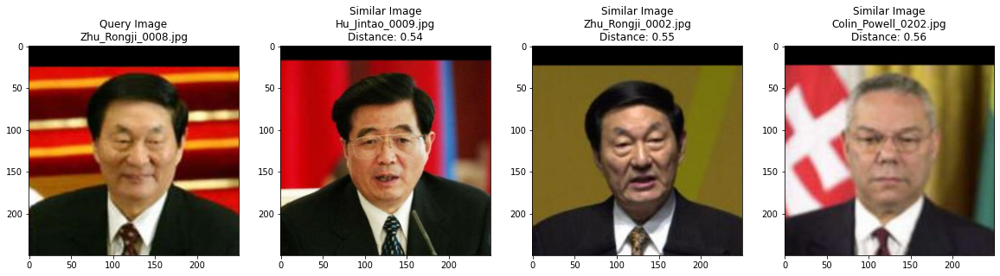

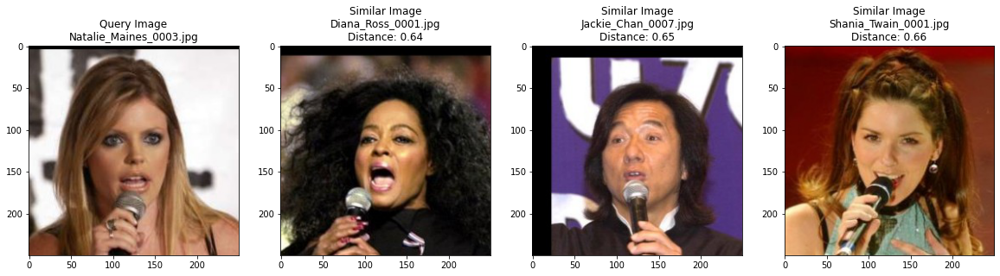

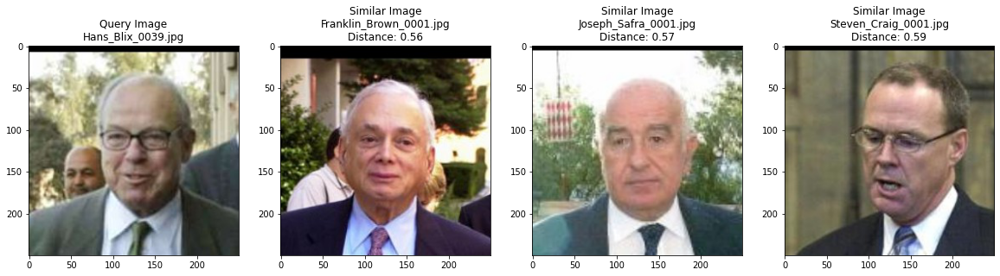

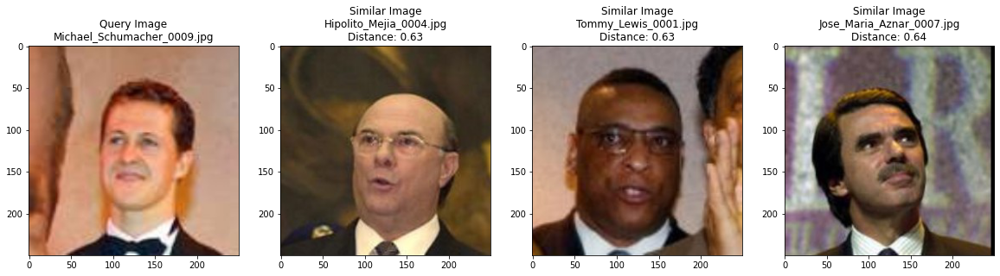

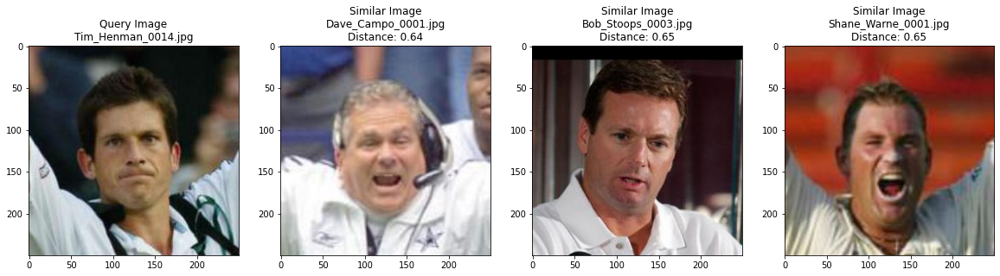

In [ ]:
for i in range(5):
    random_image_index = random.choice(indexes_multi)
    start = time.time()
    distances, indices = neighbors1.kneighbors(
        [feature_list1[random_image_index]])
    end = time.time()
    # Don't take the first closest image as it will be the same image
    similar_image_paths = [filenames[random_image_index]] + \
        [filenames[indices[0][i]] for i in range(1, 4)]
    plot_images(similar_image_paths, distances[0])
    print("Time taken to retrieve images: ", end - start)

###**InceptionResNet + KNN**

5 queries were generated for the baseline InceptionResNet + KNN classifier pipeline. This was done by:

1. Choosing 5 randomly selected images at index locations known to contain images belonging to a person that has atleast 5 images in the database. 

2. For each of those images, querying the database using the classifier fit to the ResNet50 feature list.

3. Generating the images and distances for the top 5 neighbors and displaying the top 3 neighbors that the pipeline selects.

Since the queried images belong to people who have more than one image inside the database, if the pipeline performed perfectly, all retrieved images should belong to the same class as the queried image.

From the images below, we can see that the InceptionResNet model produces results that seem even worse than the ResNet50 model! For a number of queried images, it seems as if the pipeline is just randomly selecting an output image and does not understand the visual context within the query image. 

Finally, we also generate the time taken to retrieve similar images from the database per query image; we can see that this query time is at around **0.062 seconds** per query. 

Time taken to retrieve images:  0.06032872200012207
Time taken to retrieve images:  0.059464216232299805
Time taken to retrieve images:  0.06195330619812012
Time taken to retrieve images:  0.06319308280944824
Time taken to retrieve images:  0.06555891036987305


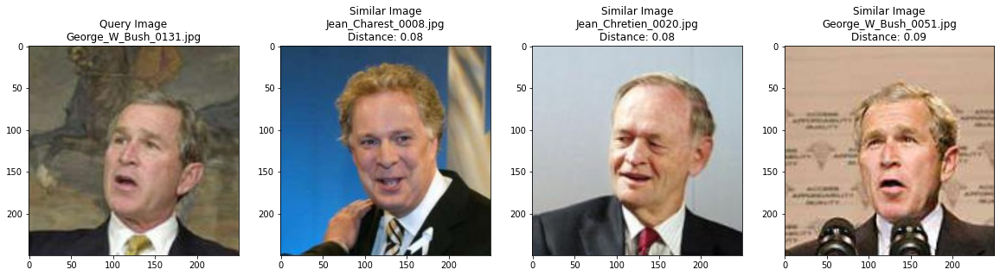

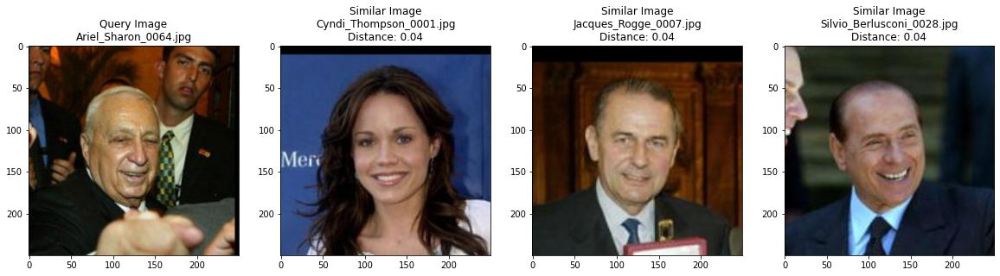

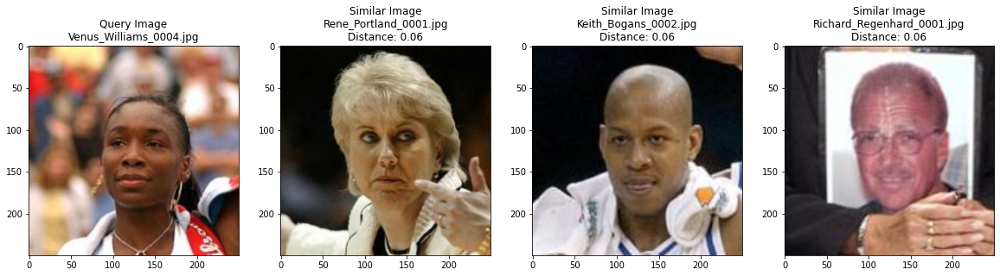

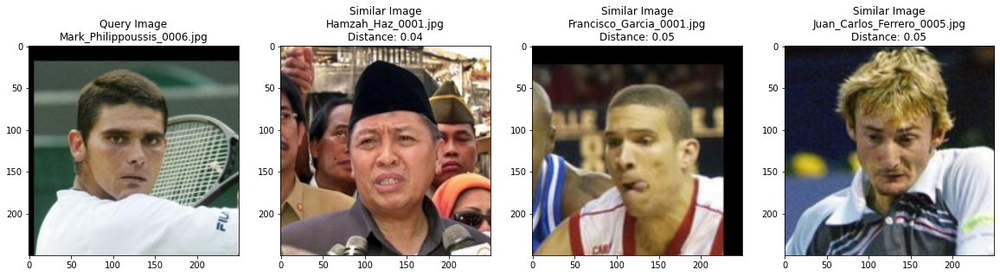

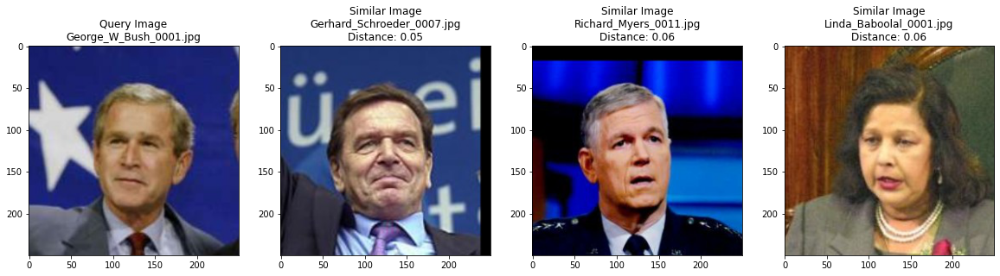

In [ ]:
for i in range(5):
    random_image_index = random.choice(indexes_multi)
    start = time.time()
    distances, indices = neighbors2.kneighbors(
        [feature_list2[random_image_index]])
    end = time.time()
    # Don't take the first closest image as it will be the same image
    similar_image_paths = [filenames[random_image_index]] + \
        [filenames[indices[0][i]] for i in range(1, 4)]
    plot_images(similar_image_paths, distances[0])
    print("Time taken to retrieve images: ", end - start)

##**Quantitative Performance Review for Baseline**

Earlier during the setup portion of the notebook, we collected all filepath indices belonging to images that belong to a person that had atleast 5 images represented within the database. Below, we propose an accuracy metric for the image search pipeline on LFW using this subset of images.

The function below takes as input the extracted embeddings from a given model and the index locations belonging to images that belong to a person that had atleast 5 images represented within the database. For the embeddings provided, it fits a KNN classifier that will retrieve the top 5 neighbors based on the embeddings. For each of these 5 guesses per query image, a correct prediction is one where the output image belongs to the class that is being queried. 

The number of people with atleast 5 images in the data set are:  **423**

The number of images in the data set belonging to a class with atleast 5 images in it are:  **5985**

Therefore, the metric below will generate **5985 * 4** predictions and there are **5985 * 4** or **23940** total **possible correct predictions**. 

100% implies that all predictions perfectly belonged to one of the 423 classes these images belong to. 

In [ ]:
def calculate_accuracy(feature_list, multi_indices):
    num_nearest_neighbors = 5
    correct_prediction = 0
    incorrect_prediction = 0
    neighbors = NearestNeighbors(n_neighbors=num_nearest_neighbors,
                                 algorithm='brute',
                                 metric='euclidean').fit(feature_list)
    start = time.time()
    for i in range(len(multi_indices)):
        distances, indices = neighbors.kneighbors([feature_list[multi_indices[i]]])
        for j in range(1, num_nearest_neighbors):
            if (classname(filenames[multi_indices[i]]) == classname(filenames[indices[0][j]])):
                correct_prediction += 1
            else:
                incorrect_prediction += 1
    end = time.time()
    accuracy = round(
        100.0 * correct_prediction /
        (1.0 * correct_prediction + incorrect_prediction), 2), end - start, correct_prediction
    return accuracy

###**ResNet50 + KNN**

As expected from the qualitative analysis above, the ResNet50 baseline pipeline performs quite poorly. It takes a total of **471 seconds** to complete the image retrieval task across all 5985 query images. The accuracy is **15.97** percent, with **3824** correct predictions. 

In [ ]:
calculate_accuracy(feature_list1, indexes_multi)

(15.97, 470.92224884033203, 3824)

###**InceptionResNet + KNN**

The InceptionResNet baseline pipeline performs even worse! It takes a total of **367 seconds** to complete the image retrieval task across all 5985 query images. The accuracy is **2.13** percent, with **510** correct predictions. 

In [ ]:
calculate_accuracy(feature_list2, indexes_multi)

(2.13, 366.82092928886414, 510)

#**Model Improvements**

For improvements over the baseline models, we made a number of changes to the overall image search pipeline.

1. Firstly, we generated the embeddings for the classifier using FaceNet.
2. We then ran PCA on the generated FaceNet embeddings to reduce the dimensions of the embeddings to improve query time.
3. We further improved upon the query time by implementing Annoy indexing on the feature list.

These improvements are detailed below.

##**Improved Embeddings with FaceNet**

###**Architecture and Objective Function for FaceNet as Motivation**

FaceNet is an record-breaking facial recognition system proposed by Google Research in 2015. It achieves high performance facial recognition by first generating high quality face mappings using various deep learning architectures and methodologies (for our purposes, we will use **MTCNN** to generate face mappings) and trains an architecture such as **InceptionResNet** with **triplet loss** as the loss function. 

A **siamese network** is a dual network with identical weights and architecture that takes an image of a person as input and then generates the image embeddings of it. The same network is then used without any updates to create embeddings for another image. Finally a similarity score will be computed using the two embeddings to decide whether two image all same person or not. 

With a **triplet loss function**, the process is similar. Triplet loss comes with three images, **Anchor, Positive and Negative**. Anchor and Positive image will fall into same class (i.e same person) and Anchor and Negative will be different class. The embeddings for these three images will then be generated using the same network and a triplet loss function will be used to compute the loss value for this triplet set. The triplet loss function computes the euclidean distance between Anchor and Positive and also between Anchor and Negative. The distance between Anchor and Positive should be smaller than distance between Anchor and Negative. The actual triplet loss is shown below.

$$
L = \max(d(A, P)-d(A,N)+\text {margin}, 0)
$$


As we can see, in order to minimize the triplet loss function the models needs to generate vectors for Anchor and Positive images as close as possible in euclidean space and also generate vectors for Anchor and Negative as far from each other as possible. Margin will be a hyperparameter that controls how far away the dissimilarities for a triplet should be. By using the triplet loss function Facenet will learn to create image embeddings near to each other for images that falls into same class.

###**Using facenet-pytorch to generate embeddings**


The facenet-pytorch package provides easy-to-use FaceNet implementation using Pytorch. We will use its MTCNN and InceptionResnetV1 classes in our experiment. The MTCNN class is a face landmark detector which can cut the original LFW images down to contain only the "facial features". The InceptionResnetV1 class with parameter "pretrained" set as "vggface2" loads a pretrained Inception Resnet V1 network, which is the network described in the FaceNet paper. 

In [ ]:
# use GPU if we have one
if torch.cuda.is_available():
  device = 'cuda'
else:
  device = 'cpu'

# mtcnn is required by facenet, it will find and align faces in image
mtcnn = MTCNN(device=device)

# pretrained facenet
model = InceptionResnetV1(pretrained='vggface2', device=device).eval()


with open('vectors.csv', 'ab') as f:
  for i in tqdm_notebook(range(len(filenames))):
    input_shape = (250, 250, 3)
    img = image.load_img(filenames[i],
                         target_size=(input_shape[0], input_shape[1]))
    img_array = image.img_to_array(img, dtype="uint8")
    aligned = mtcnn(img_array).to(device)
    vectors = model(aligned[None, :]).detach().cpu()
    #flattened_features = vectors.flatten()
    #normalized_vectors = flattened_features / norm(flattened_features)
    np.savetxt(f, vectors, delimiter=',')
    #np.savetxt(f, normalized_vectors, delimiter=',')

    torch.cuda.empty_cache()

  0%|          | 0.00/107M [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  from ipykernel import kernelapp as app


  0%|          | 0/13233 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:780: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


In [ ]:
vectors = np.loadtxt('vectors.csv', float, delimiter=',')

In [ ]:
print("Num images   = ", len(filenames))
print("Shape of feature_list for FaceNet = ", vectors.shape)

Num images   =  13233
Shape of feature_list for FaceNet =  (13233, 512)


In [ ]:
num_images = len(filenames)
num_features_per_image = len(vectors[0])
print("Number of images = ", num_images)
print("Number of features per image for FaceNet = ", num_features_per_image)

Number of images =  13233
Number of features per image for FaceNet =  512


###**Setup Classifier for Baseline Models**

In [ ]:
neighbors = NearestNeighbors(n_neighbors=5,
                             algorithm='brute',
                             metric='euclidean').fit(vectors)

###**Qualitative Performance Review for FaceNet**

5 queries were generated for the FaceNet + KNN classifier pipeline. This was done by:

1. Choosing 5 randomly selected images at index locations known to contain images belonging to a person that has atleast 5 images in the database.

2. For each of those images, querying the database using the classifier fit to the FaceNet feature list.

3. Generating the images and distances for the top 5 neighbors and displaying the top 3 neighbors that the pipeline selects.

Since the queried images belong to people who have more than one image inside the database, if the pipeline performed perfectly, all retrieved images should belong to the same class as the queried image.

From the images below, we can see that unlike before, the images produced by FaceNet queries reliably belong to the correct person being queried!

Finally, we also generate the time taken to retrieve similar images from the database per query image; we can see that this query time is at around **0.014 seconds** per query and is faster then both baselines observed before. 

Time taken to retrieve images:  0.014362096786499023
Time taken to retrieve images:  0.014116525650024414
Time taken to retrieve images:  0.01426243782043457
Time taken to retrieve images:  0.015089273452758789
Time taken to retrieve images:  0.01415252685546875


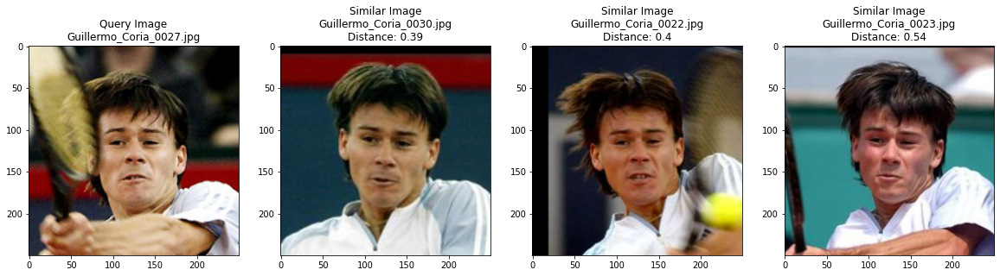

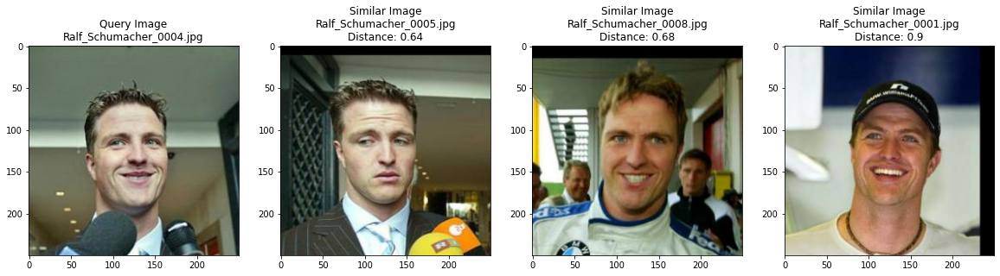

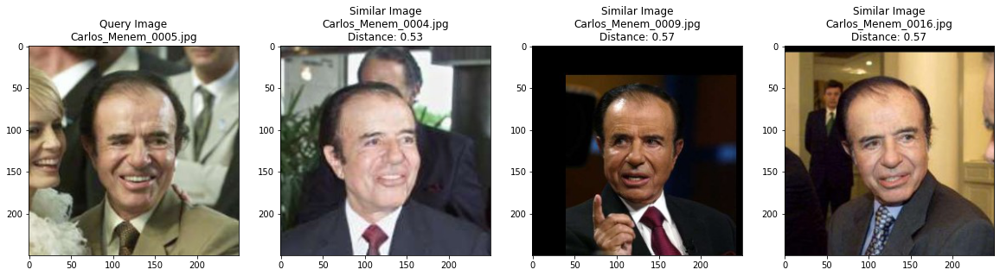

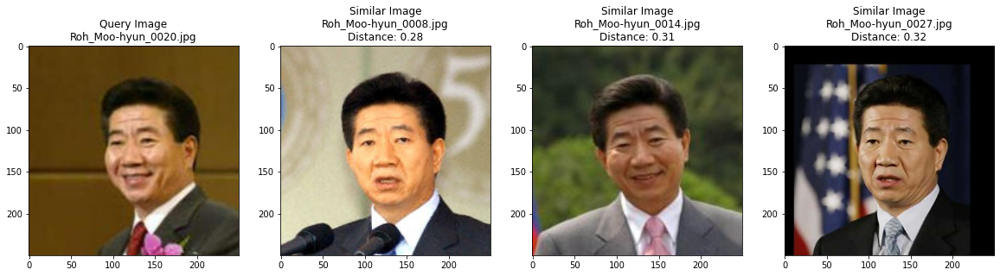

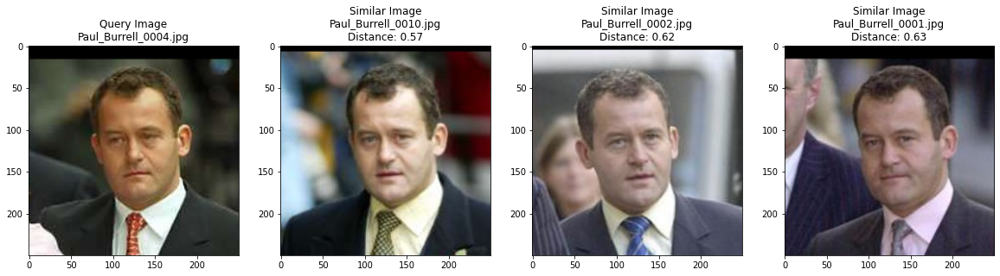

In [ ]:
for i in range(5):
    random_image_index = random.choice(indexes_multi)
    start = time.time()
    distances, indices = neighbors.kneighbors(
        [vectors[random_image_index]])
    end = time.time()
    # Don't take the first closest image as it will be the same image
    similar_image_paths = [filenames[random_image_index]] + \
        [filenames[indices[0][i]] for i in range(1, 4)]
    plot_images(similar_image_paths, distances[0])
    print("Time taken to retrieve images: ", end - start)


###**Quantitative Performance Review for FaceNet**

We repeat the accuracy evaluation from before to confirm our suspicions from the qualitative review.  Unlike before, FaceNet produces **significantly** better predictions. Our accuracy is now at **94.1**% with a whopping **22527** correct predictions out of the  23940 total possible correct predictions. 

FaceNet also performs faster as well, requiring only **77** seconds to complete the evaluation. 

In [ ]:
calculate_accuracy(vectors, indexes_multi)

(94.1, 76.63664293289185, 22527)

###**t-SNE Visualization of Class Separation for Accuracy Test with FaceNet**

**t-distributed stochastic neighbor embedding (t-SNE)** is a statistical method for visualizing high-dimensional data by giving each datapoint a location in a two or three-dimensional map. It converts similarities between data points to joint probabilities and tries to minimize the Kullback-Leibler divergence between the joint probabilities of the low-dimensional embedding and the high-dimensional data. We use this tool below to show how FaceNet's embeddings can be used to separate the images belonging to classes with atleast more than 5 images into distinct clusters, thereby explaining the relatively high accuracy for the improved pipeline over these images.

In [ ]:
c_id = []
for i in range(len(vectors[indexes_multi])):
  c_id.append(i)

In [ ]:
tsne_results = TSNE(n_components=2,verbose=1,metric='euclidean').fit_transform(vectors[indexes_multi])

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 5985 samples in 0.002s...
[t-SNE] Computed neighbors for 5985 samples in 1.009s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5985
[t-SNE] Computed conditional probabilities for sample 2000 / 5985
[t-SNE] Computed conditional probabilities for sample 3000 / 5985
[t-SNE] Computed conditional probabilities for sample 4000 / 5985
[t-SNE] Computed conditional probabilities for sample 5000 / 5985
[t-SNE] Computed conditional probabilities for sample 5985 / 5985
[t-SNE] Mean sigma: 0.297997
[t-SNE] KL divergence after 250 iterations with early exaggeration: 85.000931
[t-SNE] KL divergence after 1000 iterations: 1.023265


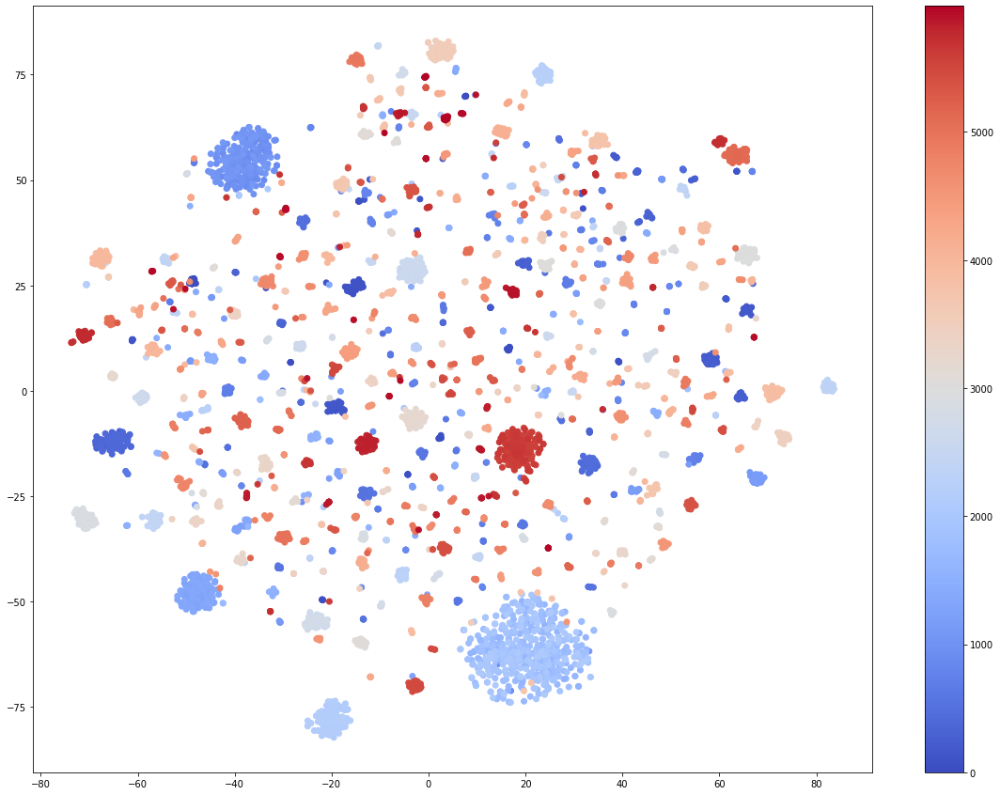

In [ ]:
plt.figure(figsize=(20, 15))
colormap = plt.cm.get_cmap('coolwarm')
scatter_plot = plt.scatter(tsne_results[:,0],tsne_results[:,1], c = c_id, cmap=colormap)
plt.colorbar(scatter_plot)
plt.show()

##**Dimensionality Reduction and Runtime Improvements with Annoy Indexing**

###**Reducing Embedding Dimensions with PCA for FaceNet**

PCA (short for Principal Component Analysis) is a statistical procedure that questions if features representing the data are equally important and is considered one of the go-to techniques for dimensionality reduction. So far, we noted that the ResNet50 baseline generated 2048 dimensions while InceptionResNet generated 1536 dimensions. In the last section, we saw that FaceNet generated 512 dimensions. In the following sections, we use PCA to see if all 512 dimensions are necessary. 

We begin below by using the accuracy metric previously defined to check FaceNet's performance with all 512 dimensions and the runtime of the pipeline.

In [ ]:
feature_list = vectors

In [ ]:
num_images = len(filenames)
num_features_per_image = len(feature_list[0])
print("Number of images = ", num_images)
print("Number of features per image = ", num_features_per_image)

Number of images =  13233
Number of features per image =  512


In [ ]:
# Helper function to get the classname and filename
def classname_filename(str):
    return str.split('/')[-2] + '/' + str.split('/')[-1]


# Helper function that calculates accuracy using the nearest neighbors brute force algorithm
def calculate_accuracy(feature_list, multi_indices):
    num_nearest_neighbors = 5
    correct_prediction = 0
    incorrect_prediction = 0
    neighbors = NearestNeighbors(n_neighbors=num_nearest_neighbors,
                                 algorithm='brute',
                                 metric='euclidean').fit(feature_list)
    start = time.time()
    for i in range(len(multi_indices)):
        distances, indices = neighbors.kneighbors([feature_list[multi_indices[i]]])
        for j in range(1, num_nearest_neighbors):
            if (classname(filenames[multi_indices[i]]) == classname(filenames[indices[0][j]])):
                correct_prediction += 1
            else:
                incorrect_prediction += 1
    end = time.time()
    accuracy = round(
        100.0 * correct_prediction /
        (1.0 * correct_prediction + incorrect_prediction), 2), end - start
    return accuracy

In [ ]:
print("Accuracy on original feature set : ",
      calculate_accuracy(feature_list[:], indexes_multi))

Accuracy on original feature set :  (94.1, 76.45838928222656)


Here, we iteratively test the accuracy of the feature list after compressing the number of dimensions with PCA. **We note that after compressing the number of dimensions to 50, the accuracy plateaus at 94.1%.** The runtime shows significant improvement for the time needed to complete the queries in the accuracy metric. With 50 dimensions, the total amount of time for all queries is only **9.84 seconds** as opposed to **76.15 seconds** with all 512 dimensions. 

In [ ]:
pca_dimensions = [1, 2, 3, 4, 5, 10, 20, 50, 75, 100, 150, 256, 512]
pca_accuracy = []
pca_time = []

for dimensions in pca_dimensions:
    pca = PCA(n_components=dimensions)
    pca.fit(feature_list)
    feature_list_compressed = pca.transform(feature_list[:])
    # Calculate accuracy over the compressed features
    accuracy, t = calculate_accuracy(feature_list_compressed[:], indexes_multi)
    pca_time.append(t)
    pca_accuracy.append(accuracy)
    print("For PCA Dimensions = ", dimensions, ",\tAccuracy = ", accuracy, "%",
          ",\tTime = ", pca_time[-1])

For PCA Dimensions =  1 ,	Accuracy =  9.28 % ,	Time =  3.0521340370178223
For PCA Dimensions =  2 ,	Accuracy =  13.08 % ,	Time =  4.960877895355225
For PCA Dimensions =  3 ,	Accuracy =  20.23 % ,	Time =  5.0935375690460205
For PCA Dimensions =  4 ,	Accuracy =  28.35 % ,	Time =  5.44281530380249
For PCA Dimensions =  5 ,	Accuracy =  37.76 % ,	Time =  5.710234880447388
For PCA Dimensions =  10 ,	Accuracy =  69.97 % ,	Time =  5.9232399463653564
For PCA Dimensions =  20 ,	Accuracy =  88.12 % ,	Time =  7.012950658798218
For PCA Dimensions =  50 ,	Accuracy =  94.1 % ,	Time =  9.84528112411499
For PCA Dimensions =  75 ,	Accuracy =  94.1 % ,	Time =  12.747347593307495
For PCA Dimensions =  100 ,	Accuracy =  94.1 % ,	Time =  15.05843210220337
For PCA Dimensions =  150 ,	Accuracy =  94.1 % ,	Time =  20.33775496482849
For PCA Dimensions =  256 ,	Accuracy =  94.1 % ,	Time =  31.728549242019653
For PCA Dimensions =  512 ,	Accuracy =  94.1 % ,	Time =  76.14974403381348


A plot of the accuracy for each PCA dimension and the cumulative variance is provided below; together, they indicate that the 512 dimensions can be compressed to only 50! 

<Figure size 1440x1080 with 0 Axes>

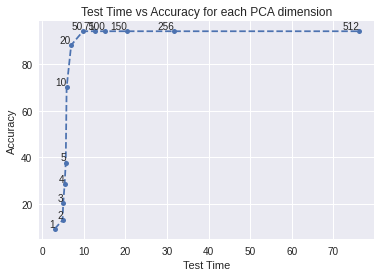

In [ ]:
plt.figure(figsize=(20, 15))
f = plt.figure()

matplotlib.style.use('seaborn')
plt.plot(pca_time, pca_accuracy, 'o--', markersize=5)
for label, x, y in zip(pca_dimensions, pca_time, pca_accuracy):
    plt.annotate(label, xy=(x, y), ha='right', va='bottom')
plt.title('Test Time vs Accuracy for each PCA dimension')
plt.xlabel('Test Time')
plt.ylabel('Accuracy')
plt.grid(True)
plt.show()

<Figure size 1440x1080 with 0 Axes>

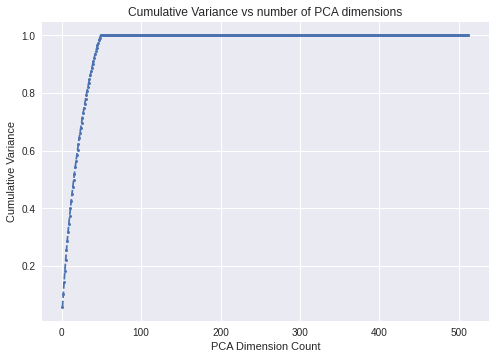

In [ ]:
plt.figure(figsize=(20, 15))
f = plt.figure()

matplotlib.style.use('seaborn')
plt.plot(range(1, 513),
         pca.explained_variance_ratio_.cumsum(),
         'o--',
         markersize=3)
plt.title('Cumulative Variance vs number of PCA dimensions')
plt.xlabel('PCA Dimension Count')
plt.ylabel('Cumulative Variance')
plt.grid(True)
plt.show()

###**Performance Review after Reducing Dimensions**

Finally, to confirm that the pipeline did not suffer from any reduced accuracy or performance after reducing dimensions, we repeated the qualitative and quantitative performance review for FaceNet with the compressed embeddings below. Please note that the accuracy remains high at 94.1% but the run time per query significantly reduced as the number of dimensions were reduced from 512 to only 50! 

In [ ]:
pca = PCA(n_components=50)
pca.fit(feature_list)
feature_list_compressed = pca.transform(feature_list[:])

In [ ]:
feature_list_compressed.shape

(13233, 50)

In [ ]:
neighbors = NearestNeighbors(n_neighbors=5,
                             algorithm='brute',
                             metric='euclidean').fit(feature_list_compressed)

Time taken to retrieve images:  0.0019164085388183594
Time taken to retrieve images:  0.0018494129180908203
Time taken to retrieve images:  0.0017681121826171875
Time taken to retrieve images:  0.0016973018646240234
Time taken to retrieve images:  0.0018222332000732422


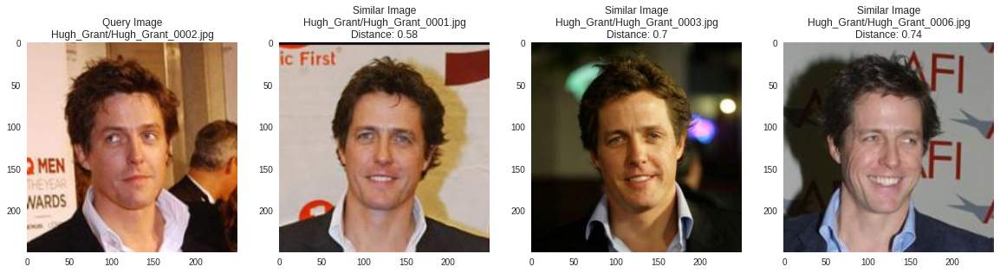

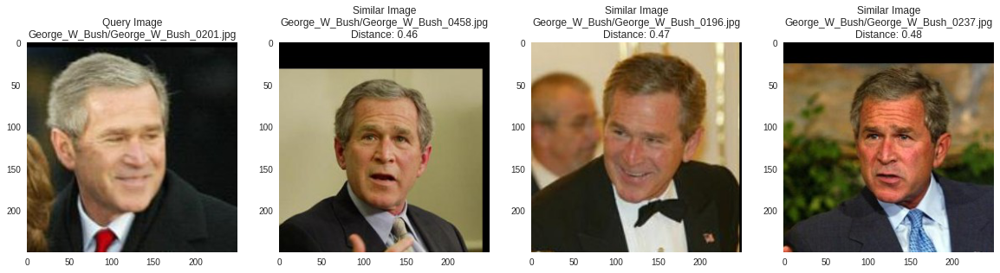

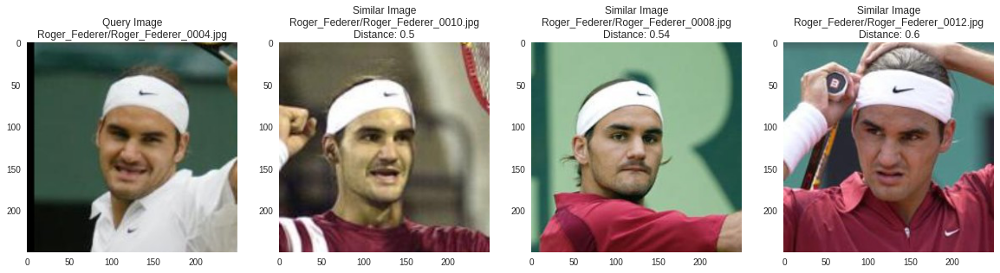

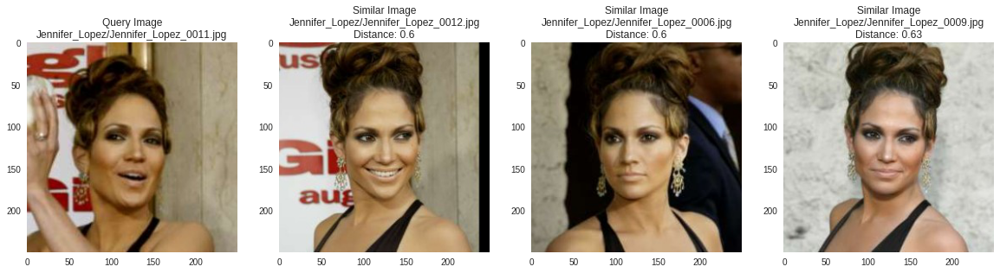

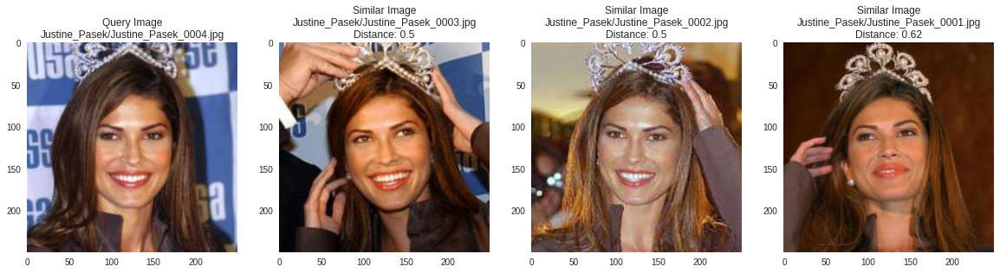

In [ ]:
for i in range(5):
    random_image_index = random.choice(indexes_multi)
    start = time.time()
    distances, indices = neighbors.kneighbors(
        [feature_list_compressed[random_image_index]])
    end = time.time()
    # Don't take the first closest image as it will be the same image
    similar_image_paths = [filenames[random_image_index]] + \
        [filenames[indices[0][i]] for i in range(1, 4)]
    plot_images(similar_image_paths, distances[0])
    print("Time taken to retrieve images: ", end - start)

###**t-SNE Review after Reducing Dimensions**

Finally, we also included a t-SNE visualization of the compressed feature list to show that the pipeline maintained good class separation and discernment with the compressed feature list. Please note that this was run on classes (or people) in the database with atleast 5 images, as before. 

In [ ]:
tsne_results = TSNE(n_components=2,verbose=1,metric='euclidean').fit_transform(feature_list_compressed[indexes_multi])

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 5985 samples in 0.000s...
[t-SNE] Computed neighbors for 5985 samples in 0.766s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5985
[t-SNE] Computed conditional probabilities for sample 2000 / 5985
[t-SNE] Computed conditional probabilities for sample 3000 / 5985
[t-SNE] Computed conditional probabilities for sample 4000 / 5985
[t-SNE] Computed conditional probabilities for sample 5000 / 5985
[t-SNE] Computed conditional probabilities for sample 5985 / 5985
[t-SNE] Mean sigma: 0.297997
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.978134
[t-SNE] KL divergence after 1000 iterations: 1.020719


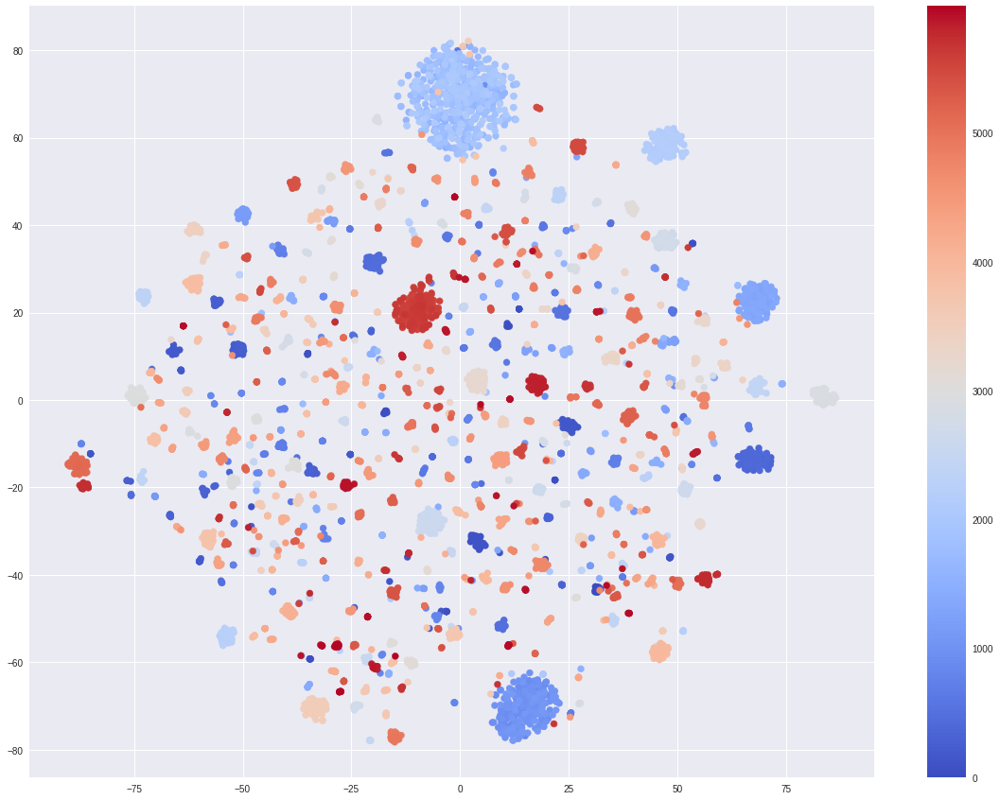

In [ ]:
plt.figure(figsize=(20, 15))
colormap = plt.cm.get_cmap('coolwarm')
scatter_plot = plt.scatter(tsne_results[:,0],tsne_results[:,1], c = c_id, cmap=colormap)
plt.colorbar(scatter_plot)
plt.show()

###**Setting Up Annoy Index for super fast queries**

**Annoy (Approximate Nearest Neighbors Oh Yeah)** is a C++ library with Python bindings to search for points in space that are close to a given query point. It also creates large read-only file-based data structures that are mmapped into memory so that many processes may share the same data.

Since we have reduced the overall dimensions of our embeddings, we will now take things a step further by setting up Annoy Indexing to further speed up image retrieval. 

In the section below, we see that the image retrieval process has become even faster, averaging at about 0.00031 seconds per query!

In [ ]:
!pip3 install annoy


     |████████████████████████████████| 646 kB 4.1 MB/s 
  Created wheel for annoy: filename=annoy-1.17.0-cp37-cp37m-linux_x86_64.whl size=391602 sha256=9bc96424d36d41a9c201aa06ad51b5a8cd48ac9d920f81e8383aacd82f1007b0
  Stored in directory: /root/.cache/pip/wheels/4f/e8/1e/7cc9ebbfa87a3b9f8ba79408d4d31831d67eea918b679a4c07
Successfully built annoy


In [ ]:
from annoy import AnnoyIndex

annoy_index = AnnoyIndex(feature_list_compressed.shape[1])  # Length of item vector that will be indexed
for i in range(feature_list_compressed.shape[0]):
    annoy_index.add_item(i, feature_list_compressed[i])
annoy_index.build(40)  #40 trees

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: The default argument for metric will be removed in future version of Annoy. Please pass metric='angular' explicitly.
  This is separate from the ipykernel package so we can avoid doing imports until


True

In [ ]:
%timeit a = annoy_index.get_nns_by_vector(feature_list_compressed[0], 5, include_distances=True )

The slowest run took 7.01 times longer than the fastest. This could mean that an intermediate result is being cached.
10000 loops, best of 5: 20.6 µs per loop


Time taken to retrieve images:  0.00029277801513671875
Time taken to retrieve images:  0.0009868144989013672
Time taken to retrieve images:  0.0007677078247070312
Time taken to retrieve images:  0.0002548694610595703
Time taken to retrieve images:  0.00023865699768066406


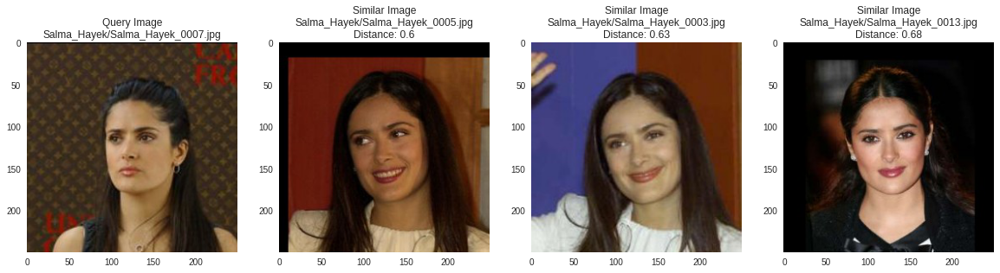

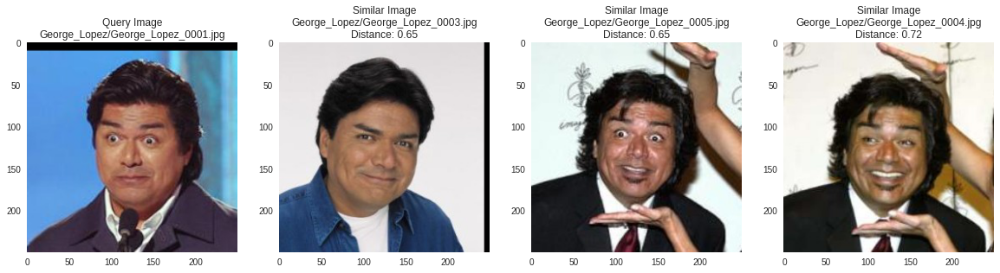

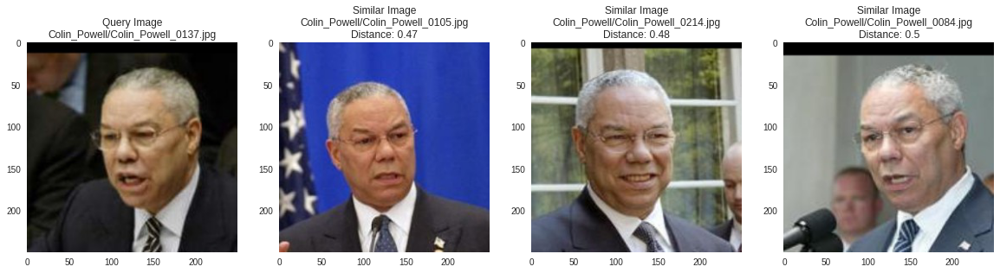

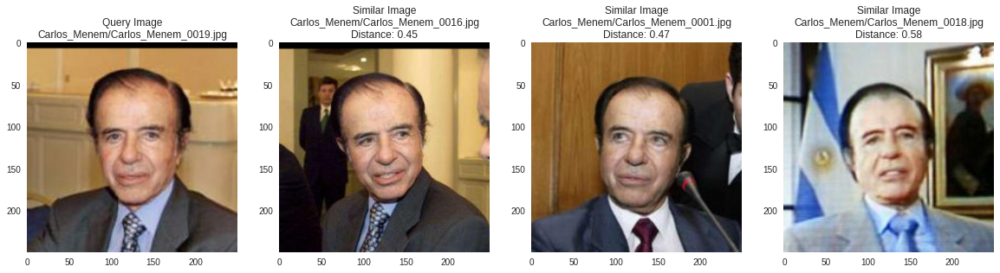

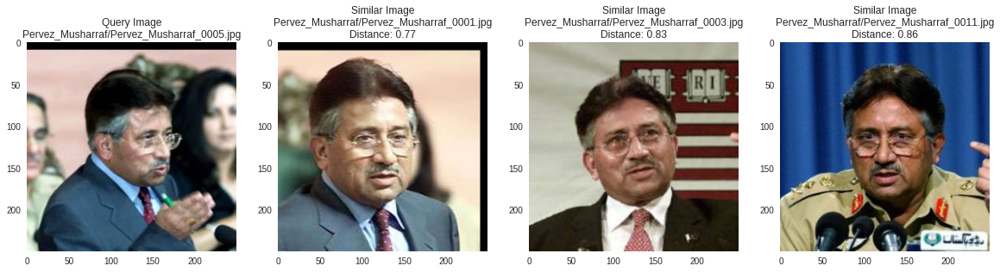

In [ ]:
for i in range(5):
    random_image_index = random.choice(indexes_multi)
    start = time.time()
    indices, distances = annoy_index.get_nns_by_vector(feature_list_compressed[random_image_index], 5, include_distances=True )
    end = time.time()
    # Don't take the first closest image as it will be the same image
    similar_image_paths = [filenames[random_image_index]] + \
        [filenames[indices[i]] for i in range(1, 4)]
    plot_images(similar_image_paths, distances)
    print("Time taken to retrieve images: ", end - start)

##**Conclusions from Experimentation**

In our experiments above, we started out with a poorly performing baseline pipeline with ResNet50 and InceptionResNet. We iteratively improved upon this baseline with the following steps:

1. We first **significantly** improved the pipeline's accuracy by using embeddings generated from FaceNet.
2. We then reduced the run time by a magnitude using PCA to reduce the number of dimensions.
3. We finally reduced the run time by a further two magnitudes by setting up Annoy Indexing. 

Overall, the improvements we implemented in our experiments **significantly** improved over the image search baseline models. These improvements are summarized in the table below. 

###**Summary table of improvements**

Pipeline | Accuracy | Average Runtime per Query
--- | --- | ---
**ResNet + KNN** | 15.97% | 0.082 sec 
**InceptionResNet + KNN** | 2.13% | 0.062 sec
**FaceNet + KNN** | 94.1% | 0.014 sec
**FaceNet + PCA + KNN** | 94.1% | 0.0018 sec
**FaceNet + PCA + Annoy** | 94.1% | 0.00048 sec



##**Model Output For 10 Test Images**

In this section, we generate the top 20 neighbors for the 10 test images selected for the project. Based on instructions provided in class, we believe the ten images to be queried are:



```
names = ["Albert_Costa", "Angela_Bassett", "Arminio_Fraga", "Billy_Crystal", "Bob_Graham", 
         "Boris_Becker", "Bulent_Ecevit", "Calista_Flockhart", "Cameron_Diaz", "Carmen_Electra"]
```

Unfortunately, each of these individuals only have **6 images in the database**! Please note that since we are retrieving the top 20 neighbors per name, only 5 of the returned neighbors will match the queried image. **The face at position 1 will be the queried image itself, and the remaining 14 are faces judged as being similar by our improved pipeline**. 

These images were generated using our **final pipeline**, which involves **FaceNet + PCA * Annoy Indexing**.

Our final pipeline consists of the following:

1. **Generate axis-aligned faces using MTCNN** on the LFW dataset.
2. Use these faces to **generate FaceNet embeddings** with the pytorch-facenet implementation.
3. **Reduce the dimensions** of the generated embeddings **with PCA**.
4. **Set up Annoy Indexing** to further improve image retrieval speed. 

Please note that for **ALL QUERIES**, the top 5 neighbors returned contained **every** image belonging to the relevant class for our improved pipeline. For example, Albert Costa's query retrieve all images relevant to Albert Costa in the top 5 neighbors.

In [ ]:
test_images

['/content/lfw/Albert_Costa/Albert_Costa_0001.jpg',
 '/content/lfw/Angela_Bassett/Angela_Bassett_0001.jpg',
 '/content/lfw/Arminio_Fraga/Arminio_Fraga_0001.jpg',
 '/content/lfw/Billy_Crystal/Billy_Crystal_0001.jpg',
 '/content/lfw/Bob_Graham/Bob_Graham_0001.jpg',
 '/content/lfw/Boris_Becker/Boris_Becker_0001.jpg',
 '/content/lfw/Bulent_Ecevit/Bulent_Ecevit_0001.jpg',
 '/content/lfw/Calista_Flockhart/Calista_Flockhart_0001.jpg',
 '/content/lfw/Cameron_Diaz/Cameron_Diaz_0001.jpg',
 '/content/lfw/Carmen_Electra/Carmen_Electra_0001.jpg']

In [ ]:
test_image_indices

[209, 642, 901, 1338, 1390, 1445, 1601, 1616, 1624, 1751]

In [ ]:
def plot_test_images(filenames, distances):
    images = []
    for filename in filenames:
        images.append(mpimg.imread(filename))
    plt.figure(figsize=(40, 20))
    columns = 4
    for i, image in enumerate(images):
        ax = plt.subplot(len(images) / columns + 1, columns, i + 1)
        ax.grid(False)
        if i == 0:
            ax.set_title("Query Image\n" + classname_filename(filenames[i]))
        else:
            ax.set_title("Similar Image\n" + classname_filename(filenames[i]) +
                         "\nDistance: " +
                         str(float("{0:.2f}".format(distances[i]))))
        plt.suptitle("Results for Queried Image:")
        #plt.tight_layout()
        plt.subplots_adjust(bottom=0.1, 
                    top=0.9, 
                    hspace=0.4)
        plt.imshow(image)
        

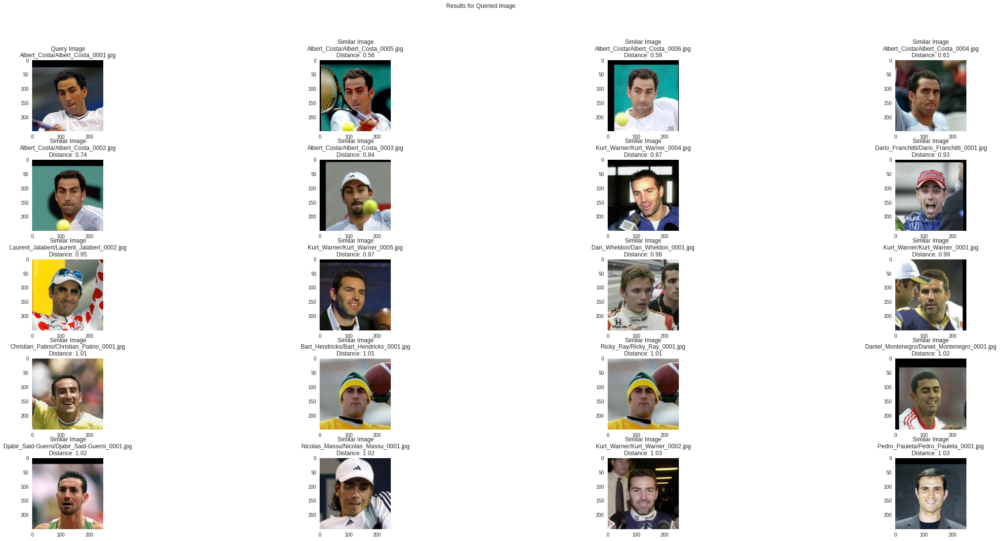

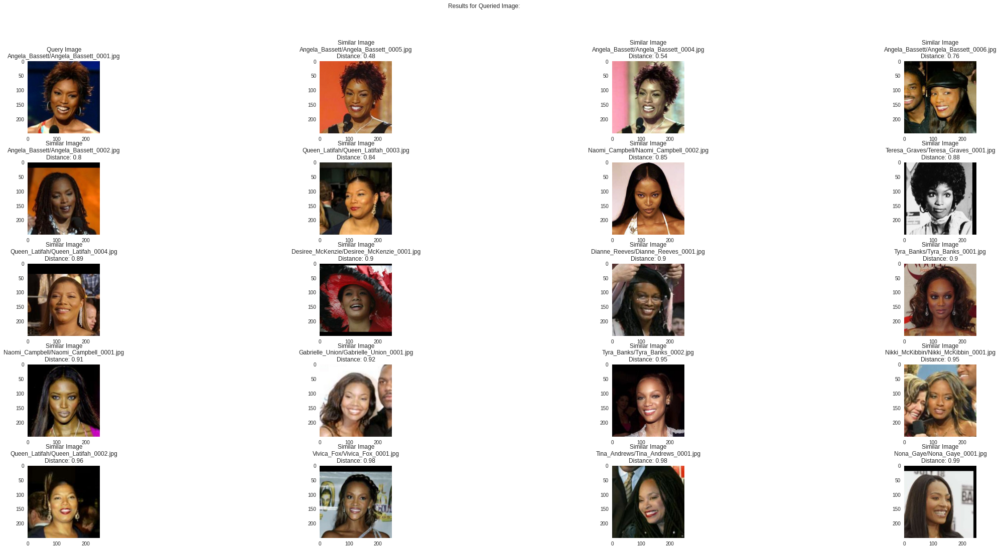

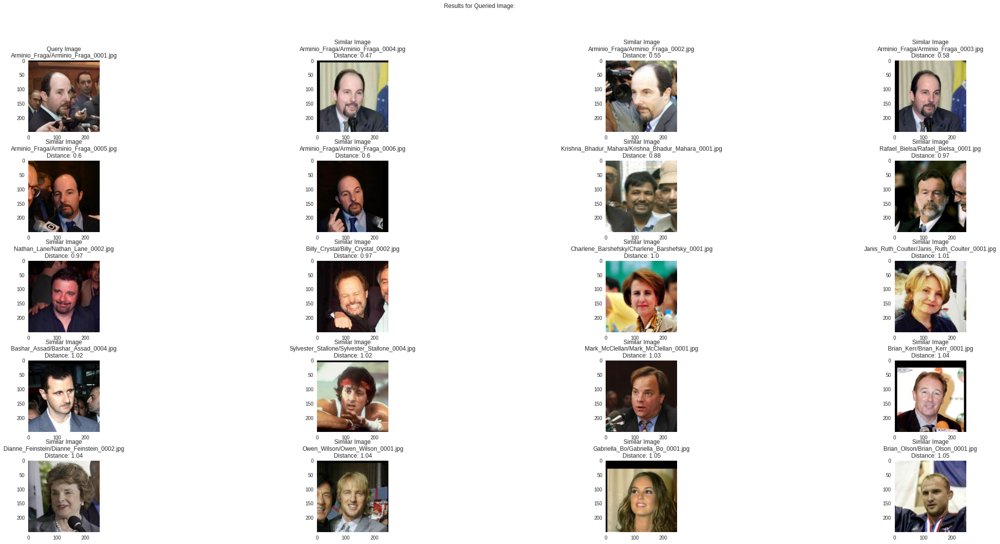

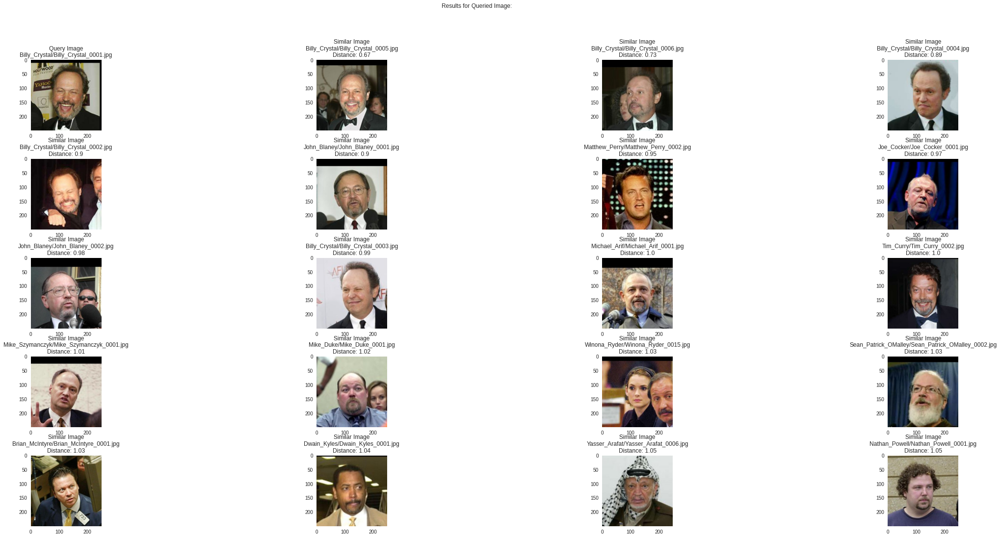

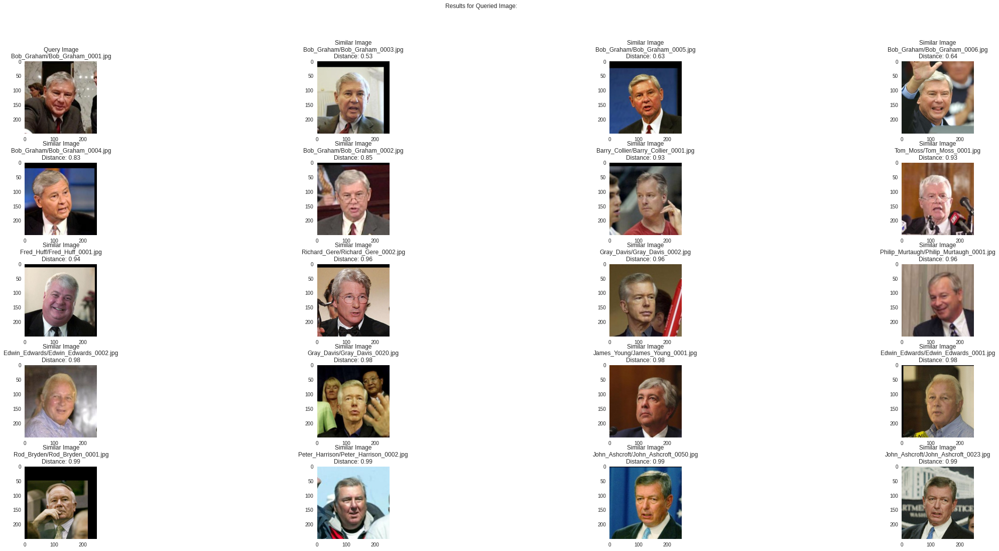

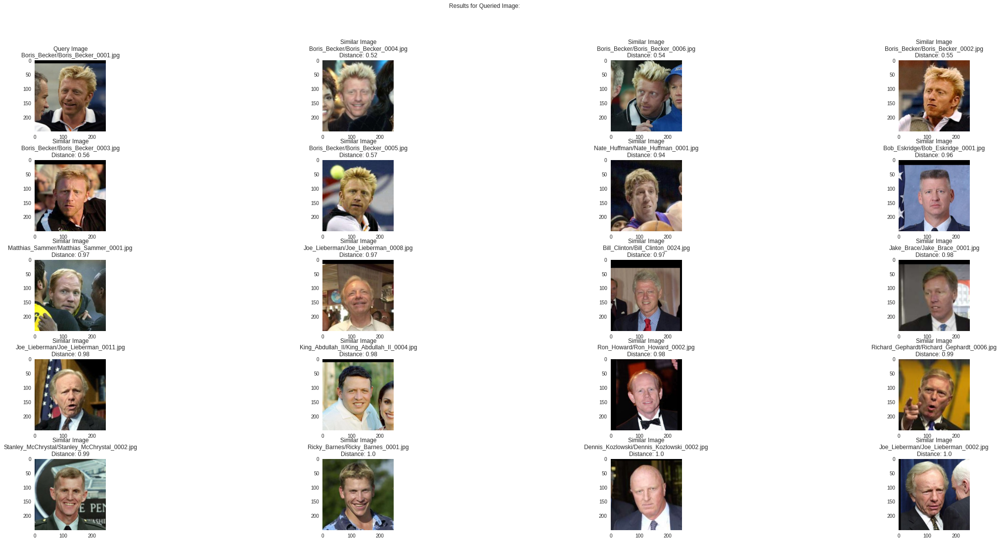

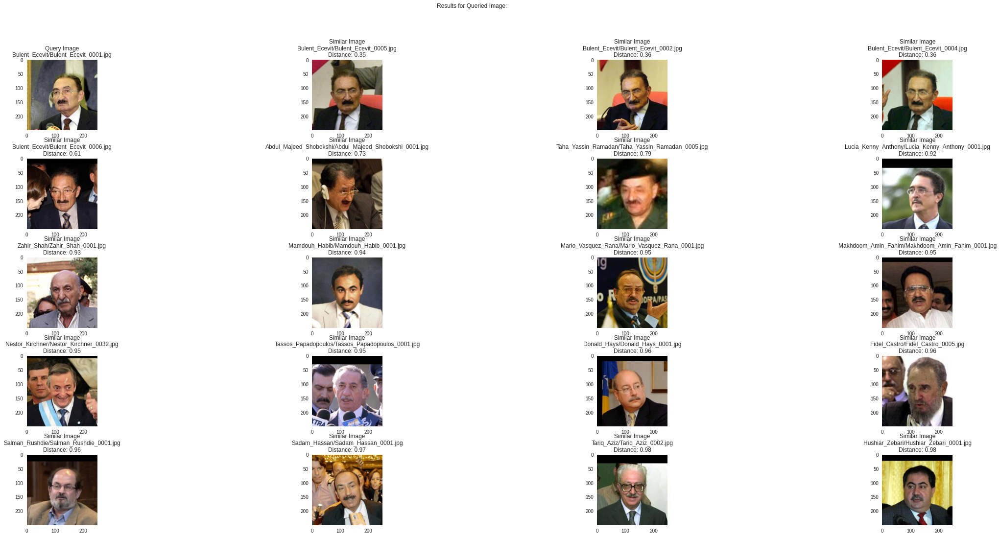

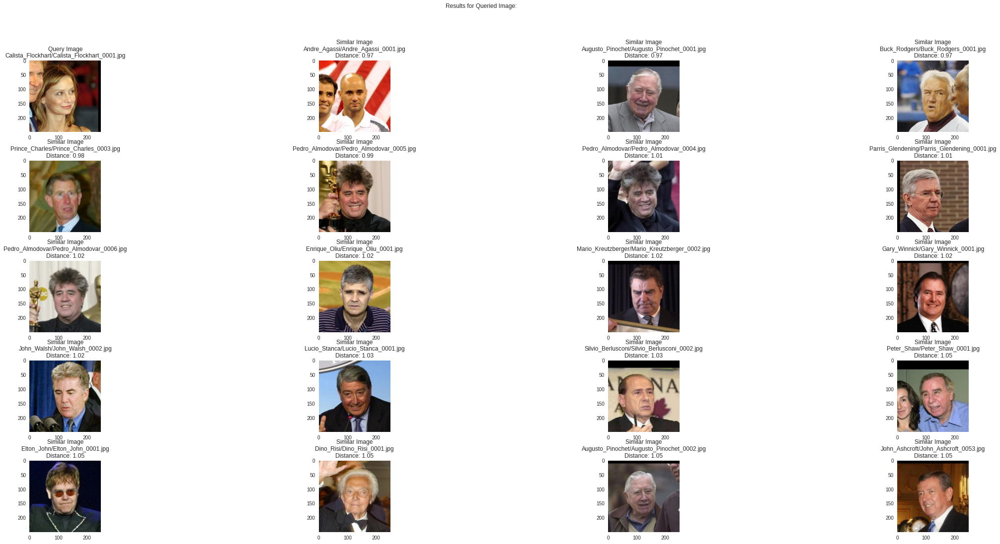

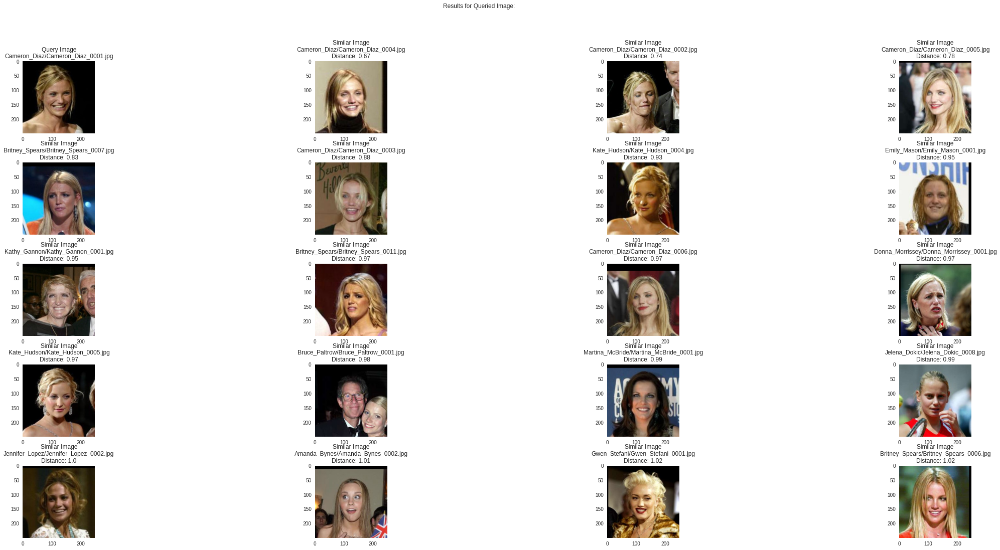

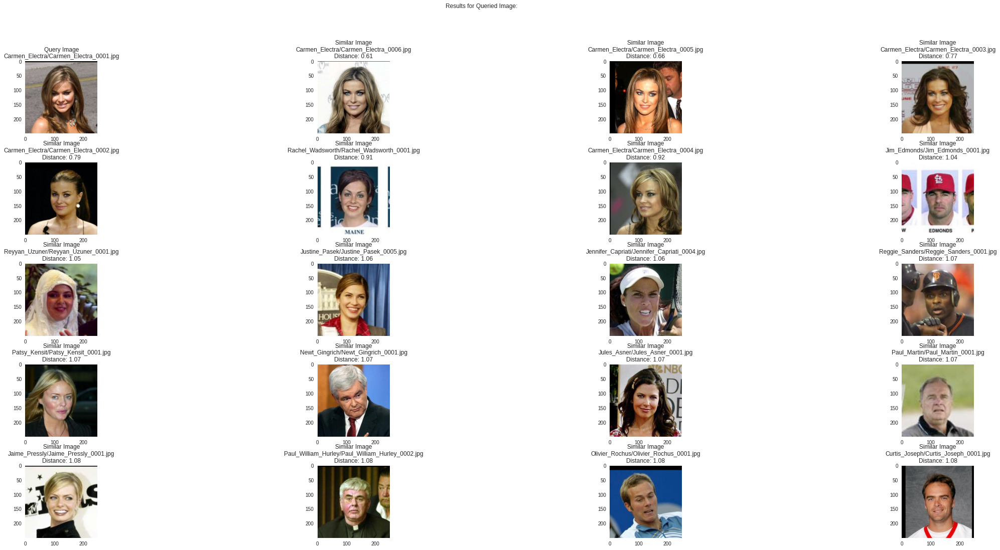

In [ ]:
for i in range(len(test_image_indices)):
    image_index = test_image_indices[i]
    start = time.time()
    indices, distances = annoy_index.get_nns_by_vector(feature_list_compressed[image_index], 20, include_distances=True )
    end = time.time()
    # Don't take the first closest image as it will be the same image
    similar_image_paths = [filenames[image_index]] + \
        [filenames[indices[i]] for i in range(1, 20)]
    plot_test_images(similar_image_paths, distances)